In [2]:
import pandas as pd
import matplotlib.pyplot as plt
# from fbprophet import Prophet
from prophet import Prophet

In [3]:
df = pd.read_csv('../data/co2-ppm-daily_csv.csv')

In [4]:
df

,date,value
0,1958-03-30,316.16
1,1958-03-31,316.40
2,1958-04-02,317.67
3,1958-04-03,317.76
4,1958-04-04,317.09
...,...,...
19382,2019-11-19,410.17
19383,2019-11-20,410.05
19384,2019-11-21,410.49
19385,2019-11-22,410.48


In [5]:
df['date'] = pd.to_datetime(df['date'])
df.columns = ['ds', 'y']

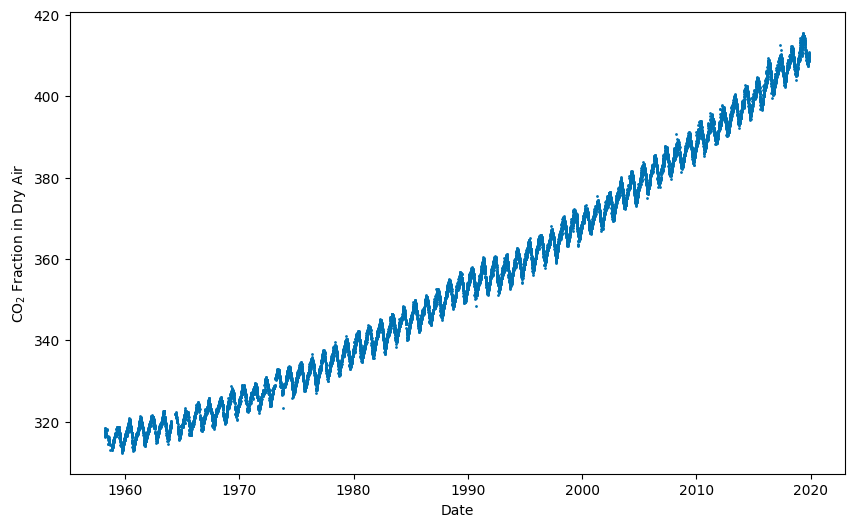

In [6]:
plt.figure(figsize=(10, 6))
plt.scatter(pd.to_datetime(df['ds']), df['y'], s=1, c='#0072B2')
plt.xlabel('Date')
plt.ylabel(r'CO$_2$ Fraction in Dry Air')
plt.show()

In [7]:
model = Prophet()
model.fit(df)

15:34:08 - cmdstanpy - INFO - Chain [1] start processing
15:34:28 - cmdstanpy - INFO - Chain [1] done processing


In [8]:
future = model.make_future_dataframe(periods=365 * 10)
forecast = model.predict(future)

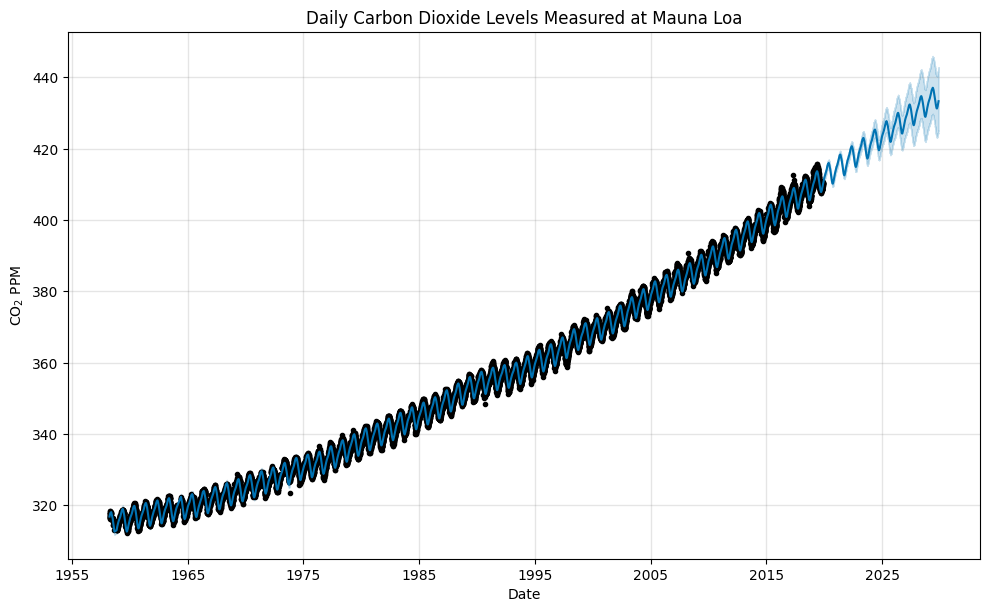

In [9]:
fig = model.plot(forecast, xlabel='Date', ylabel=r'CO$_2$ PPM')
plt.title('Daily Carbon Dioxide Levels Measured at Mauna Loa')
plt.show()

In [10]:
forecast.head(3).T

,0,1,2
ds,1958-03-30 00:00:00,1958-03-31 00:00:00,1958-04-02 00:00:00
trend,314.87972,314.882138,314.886974
yhat_lower,316.083761,316.088073,316.180364
yhat_upper,317.727761,317.7522,317.812066
trend_lower,314.87972,314.882138,314.886974
trend_upper,314.87972,314.882138,314.886974
additive_terms,1.98548,2.015653,2.118556
additive_terms_lower,1.98548,2.015653,2.118556
additive_terms_upper,1.98548,2.015653,2.118556
weekly,0.003242,-0.01061,0.003424


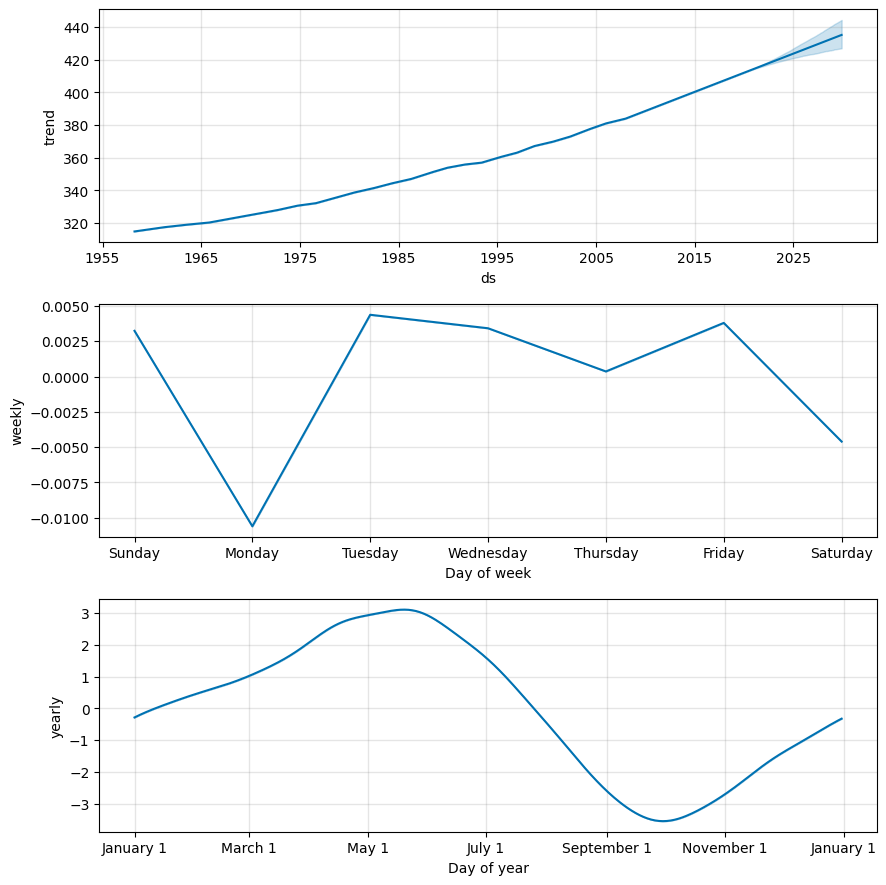

In [11]:
fig2 = model.plot_components(forecast)
plt.show()

In [12]:
import plotly.offline as py
py.init_notebook_mode()

In [13]:
from prophet.plot import (
    plot_plotly,
    plot_components_plotly,
    plot_forecast_component_plotly,
    plot_seasonality_plotly
)

In [17]:
fig = plot_plotly(model, forecast, trend=True)
# py.iplot(fig)
fig.show()

In [18]:
fig = plot_components_plotly(model, forecast, figsize=(800,200))
# py.iplot(fig)
fig.show()